In [1]:
from analysis import *
import os
import random
import glob
import pandas as pd
import gdown
import tensorflow as tf
import keras
import splitfolders
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")

# For Reproducibility
np.random.seed(42)
tf.random.set_seed(42)

data_link = "https://drive.google.com/file/d/1clZX-lV_MLxKHSyeyTheX5OCQtNCUcqT/view?usp=sharing"

2024-02-10 11:57:05.287356: I external/local_tsl/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2024-02-10 11:57:05.501988: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-10 11:57:05.502035: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-10 11:57:05.538364: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-02-10 11:57:05.586479: I external/local_tsl/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2024-02-10 11:57:05.587622: I tensorflow/core/platform/cpu_feature_guard.cc:1

In [2]:
import os
import configparser

config_path = os.path.join(os.getcwd(), "config_file.config")

config_parser = configparser.ConfigParser()
config_parser.read(config_path)

# All config Inputs
data_gsheet_id = config_parser.get('project_config', 'data_gsheet_id')
output_zip_file = config_parser.get('project_config', 'output_zip_file')
ninjacart_data_folder = config_parser.get('project_config', 'ninjacart_data_folder')
train_sub_folder = config_parser.get('project_config', 'train_sub_folder')
val_sub_folder = config_parser.get('project_config', 'val_sub_folder')
test_sub_folder = config_parser.get('project_config', 'test_sub_folder')

IMAGE_SIZE = config_parser.getint('project_config', 'IMAGE_SIZE')

# Path for dataset
train_path = os.path.join(os.getcwd(), ninjacart_data_folder, train_sub_folder)
val_path = os.path.join(os.getcwd(), ninjacart_data_folder, val_sub_folder)
test_path = os.path.join(os.getcwd(), ninjacart_data_folder, test_sub_folder)

In [3]:
if not os.path.exists(train_path):
    gdown.download(id=data_gsheet_id, output=output_zip_file)
    
    # importing required modules
    from zipfile import ZipFile

    # opening the zip file in READ mode
    with ZipFile(output_zip_file, 'r') as zip:
        # printing all the contents of the zip file
        zip.printdir()

        # extracting all the files
        print('Extracting all the files now...')
        zip.extractall()
        print('Done!')    
  


In [4]:
remove_path(path=output_zip_file)    

if not os.path.exists(val_path):
    
    splitfolders.ratio(train_path, 
                       output='output', 
                       seed=1337, 
                       ratio=(.8, .2), 
                       group_prefix=None, 
                       move=False)
    
    remove_path(path=train_path)  

    move_directory(source_path=os.path.join('output', train_sub_folder), 
                destination_path=train_path)


    move_directory(source_path=os.path.join('output', val_sub_folder), 
                destination_path=val_path)

    remove_path(path='output')

The path ninjacart_data.zip does not exist.


In [5]:
#tf.distribute.Strategy is a TensorFlow API to distribute training across multiple GPUs,
#multiple machines, or TPUs. Using this API, you can distribute your existing models and
#training code with minimal code changes.


try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver.connect()
    print("Device:", tpu.master())
    strategy = tf.distribute.TPUStrategy(tpu)
except:
    strategy = tf.distribute.get_strategy()
print("Number of replicas:", strategy.num_replicas_in_sync)

Number of replicas: 1


In [6]:
AUTOTUNE = tf.data.AUTOTUNE

# Specifying our training batch size
BATCH_SIZE = 32 * strategy.num_replicas_in_sync

# Specifying the image size
IMAGE_SIZE = [IMAGE_SIZE, IMAGE_SIZE]

# List containing class names, which will be used to index on our model output
# 0 = NORMAL, 1 = PNEUMONIA
CLASS_NAMES = ["tomato", "potato", "onion", "indian market"]

### Visualizing across classes

##### Train data visuals

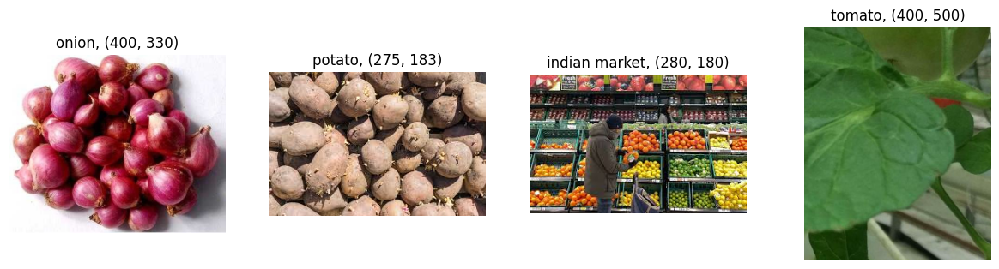

In [7]:
visual_handler = VisualHandler(folder_path=train_path)

visual_handler.visual_representation_by_class()

Count of training samples per class:
            class  count
0          onion    679
1         potato    718
2  indian market    479
3         tomato    631


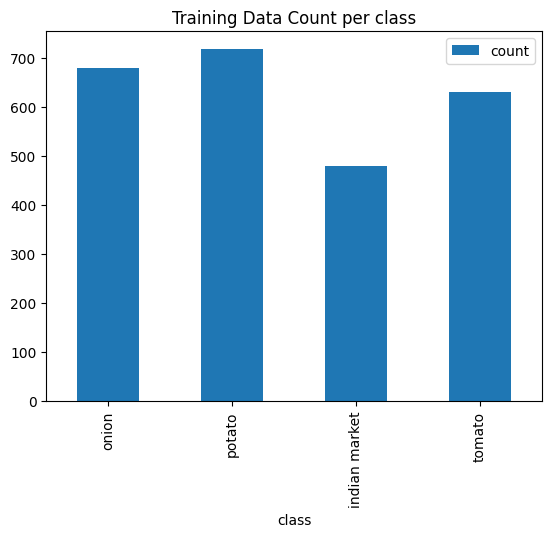

In [8]:
visual_handler.class_count()

##### Test data visuals

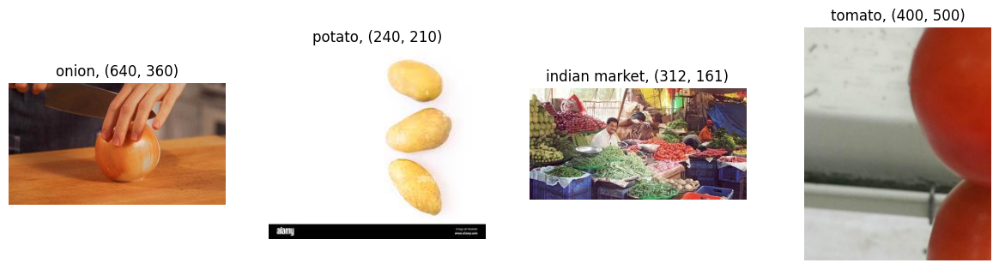

In [9]:
visual_handler = VisualHandler(folder_path=test_path)

visual_handler.visual_representation_by_class()

Count of training samples per class:
            class  count
0          onion     83
1         potato     81
2  indian market     81
3         tomato    106


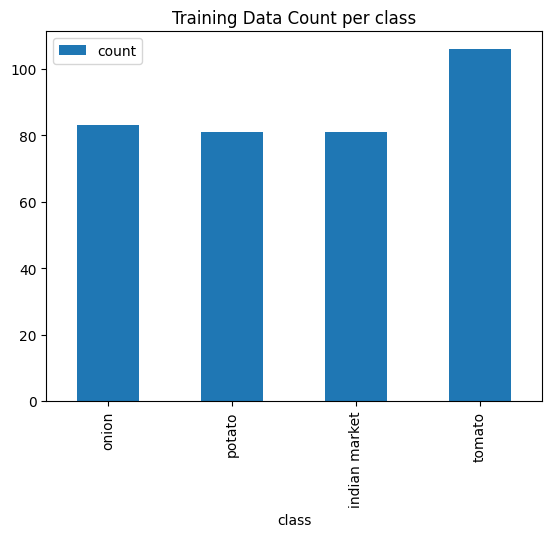

In [10]:
visual_handler.class_count()

### Preprocessing data

In [11]:
train_data = tf.keras.utils.image_dataset_from_directory(train_path,
                                                         shuffle=True, 
                                                         seed=123,
                                                         image_size=tuple(IMAGE_SIZE),
                                                         batch_size=32)
val_data = tf.keras.utils.image_dataset_from_directory(val_path,
                                                       shuffle=False, 
                                                       seed=123,
                                                       image_size=tuple(IMAGE_SIZE),
                                                       batch_size=32)
test_data = tf.keras.utils.image_dataset_from_directory(test_path,
                                                        shuffle=False, 
                                                        seed=123,
                                                        image_size=tuple(IMAGE_SIZE),
                                                        batch_size=32)

test_images = []

for folder in os.listdir(test_path):
  for image in os.listdir(os.path.join(test_path, folder)):
    test_images.append(os.path.join(test_path, folder, image))

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.


#### Treating Class Imbalance

In [12]:
TOTAL_COUNT = sum(1 for _ in train_data.unbatch())
class_weight = {}
for index, image_class in enumerate(CLASS_NAMES):
    DIR = os.path.join(train_path, image_class)
    COUNT_CLASS = len([name for name in os.listdir(DIR) if os.path.isfile(os.path.join(DIR, name))])
    class_weight[index] = (1 / COUNT_CLASS) * (TOTAL_COUNT) / 2.0
    
    print(f'{image_class.capitalize()} images count in training set: {COUNT_CLASS}')
    print(f"Weight for class {index}: {class_weight[index]}\n")
print('Total Count of images:', TOTAL_COUNT)

2024-02-10 11:57:18.629883: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 72721800 exceeds 10% of free system memory.
2024-02-10 11:57:18.911687: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 36158976 exceeds 10% of free system memory.


Tomato images count in training set: 631
Weight for class 0: 1.986529318541997

Potato images count in training set: 718
Weight for class 1: 1.7458217270194987

Onion images count in training set: 679
Weight for class 2: 1.8460972017673047

Indian market images count in training set: 479
Weight for class 3: 2.616910229645094

Total Count of images: 2507


### Modelling

In [13]:
experiment1 = ExperimentModelling(class_weight=class_weight, 
                                  class_names=CLASS_NAMES, 
                                  image_size=IMAGE_SIZE,
                                  test_images=test_images)

ninjacart_log has been deleted.


#### Baseline Model

In [14]:
def baseline():
    height, width = tuple(IMAGE_SIZE)
    num_classes = len(CLASS_NAMES)
    hidden_size = 256

    model = tf.keras.Sequential(
        name="baseline_cnn_model",
        layers=[
            tf.keras.layers.Conv2D(filters=16, kernel_size=3, padding="same", activation='relu', input_shape=(height, width, 3)),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Flatten(),
            tf.keras.layers.Dense(units=hidden_size, activation='relu'),
            tf.keras.layers.Dense(units=num_classes, activation='softmax')
        ]
    )
    return model

In [15]:
model = baseline()
model.summary()

2024-02-10 11:57:36.874645: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 209207296 exceeds 10% of free system memory.
2024-02-10 11:57:37.166573: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 209207296 exceeds 10% of free system memory.
2024-02-10 11:57:37.237968: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 209207296 exceeds 10% of free system memory.


Model: "baseline_cnn_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 227, 227, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2  (None, 113, 113, 16)      0         
 D)                                                              
                                                                 
 flatten (Flatten)           (None, 204304)            0         
                                                                 
 dense (Dense)               (None, 256)               52302080  
                                                                 
 dense_1 (Dense)             (None, 4)                 1028      
                                                                 
Total params: 52303556 (199.52 MB)
Trainable params: 52303556 (199.52 MB)
Non-trainable params: 0 (0.00 Byte)
____

In [16]:
experiment1.preprocess(train_data, val_data, test_data)

cats = ", ".join(CLASS_NAMES)
print(f"\nThe classes are available: {cats}")


The classes are available: tomato, potato, onion, indian market


In [17]:
model_fit = experiment1.compile_train_v1(model, epochs=15)

Epoch 1/15


: 

In [ ]:


experiment1.ConfusionMatrix()

In [ ]:
experiment1.plot_acc_loss(metric='accuracy')

In [ ]:
experiment1.grid_test_model()

In [ ]:
experiment1.evaluate_model()


In [ ]:
experiment1.cumulative_plot_image()

#### Modification 1 with Baseline

In [ ]:
def initialize_experiment(IMG_SIZE=IMAGE_SIZE):
    experiment = ExperimentModelling(class_weight=class_weight, 
                                    class_names=CLASS_NAMES, 
                                    image_size=IMG_SIZE,
                                    test_images=test_images)

    experiment.train_ds = experiment1.train_ds
    experiment.val_ds = experiment1.val_ds
    experiment.test_ds = experiment1.test_ds
    
    return experiment

experiment2 = initialize_experiment()

In [ ]:
def mod1_cnn_model():
    num_classes = 4
    hidden_size = 256
    height, width = tuple(IMAGE_SIZE)

    model = tf.keras.Sequential(
        name="mod1_cnn_model",
        layers=[
            # tf.keras.layers.Dropout(0.5),
            tf.keras.layers.Conv2D(filters=16, kernel_size=3, padding="same", input_shape=(height, width, 3)),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=32, kernel_size=3, padding="same"),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=64, kernel_size=3, padding="same"),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=128, kernel_size=3, padding="same"),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=256, kernel_size=3, padding="same"),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.GlobalAveragePooling2D(),
            tf.keras.layers.Dense(units=hidden_size),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.Dropout(0.5),
            tf.keras.layers.Dense(units=num_classes, activation='softmax')
        ]
    )

    model.build(input_shape = (None, height, width, 3))

    return model

In [ ]:
model = mod1_cnn_model()
model.summary()

In [ ]:
experiment2.compile_train_v1(model, epochs=30)

In [ ]:
# Implement a TensorBoard callback to log each of our model metrics for each model during the training process.
%load_ext tensorboard
%tensorboard --logdir={log_dir}

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(20, 7))
ax = ax.ravel()

for i, met in enumerate(["accuracy", "loss"]):
    ax[i].plot(model_fit.history[met])
    ax[i].plot(model_fit.history["val_" + met])
    ax[i].set_title("Model {}".format(met))
    ax[i].set_xlabel("epochs")
    ax[i].set_ylabel(met)
    ax[i].legend(["train", "val"])

In [ ]:
experiment2.ConfusionMatrix()

In [ ]:
# Evaluate the model
experiment2.evaluate_model()

In [ ]:
experiment2.cumulative_plot_image()

### Modification 2 with Baseline

In [ ]:
experiment3 = initialize_experiment()

In [ ]:
def mod2_cnn_model():
    num_classes = 4
    hidden_size = 256
    height, width = tuple(IMAGE_SIZE)

    model = keras.Sequential(
        name="model_cnn_2",
        layers=[
            tf.keras.layers.Conv2D(filters=16, kernel_size=3, padding="same", input_shape=(height, width, 3),
                            kernel_regularizer=tf.keras.regularizers.l2(1e-3)),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=32, kernel_size=3, padding="same",
                            kernel_regularizer=tf.keras.regularizers.l2(1e-3)),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=64, kernel_size=3, padding="same",
                            kernel_regularizer=tf.keras.regularizers.l2(1e-3)),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=128, kernel_size=3, padding="same",
                            kernel_regularizer=tf.keras.regularizers.l2(1e-3)),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=256, kernel_size=3, padding="same",
                            kernel_regularizer=tf.keras.regularizers.l2(1e-3)),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            # layers.MaxPooling2D(),
            # layers.Flatten(),
            tf.keras.layers.GlobalAveragePooling2D(),
            tf.keras.layers.Dense(units=hidden_size, kernel_regularizer=tf.keras.regularizers.l2(1e-3)),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.Dropout(0.5),
            tf.keras.layers.Dense(units=num_classes, activation='softmax')
        ]
    )

    model.build(input_shape=(None, height, width, 3))

    return model

In [ ]:
model = mod2_cnn_model()
model.summary()

In [ ]:
experiment3.compile_train_v1(model, epochs=30)

In [ ]:
experiment3.plot_acc_loss(metric='accuracy')

In [ ]:
experiment3.ConfusionMatrix()

In [ ]:
# Evaluate the model
experiment3.evaluate_model()

In [ ]:
experiment3.cumulative_plot_image()

## VGG16 without Pretrained



#### Model Building & Training

In [ ]:
IMAGE_SIZE = [224, 224]
experiment_vgg_w_pretrain = initialize_experiment(IMG_SIZE=IMAGE_SIZE)

In [ ]:
def vgg16_without_pretrained():
    num_classes = 4
    hidden_size = 256
    height, width = IMAGE_SIZE
    
    model = keras.Sequential(
        name="vgg16_without_pretrained",
        layers=[
            tf.keras.layers.Input(shape = (224 ,224, 3)),
            tf.keras.layers.Conv2D(64, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(64, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.MaxPooling2D(pool_size=(2,2), strides= (2,2)),

            tf.keras.layers.Conv2D(128, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(128, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.MaxPooling2D(pool_size=(2,2), strides= (2,2)),

            tf.keras.layers.Conv2D(256, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(256, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(256, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(256, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.MaxPooling2D(pool_size=(2,2), strides= (2,2)),

            tf.keras.layers.Conv2D(512, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(512, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(512, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(512, kernel_size=(3,3),padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.MaxPooling2D(pool_size=(2,2), strides= (2,2)),

            tf.keras.layers.Conv2D(512, kernel_size=(3,3),padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(512, kernel_size=(3,3),padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(512, kernel_size=(3,3),padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(512, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.MaxPooling2D(pool_size=(2,2), strides= (2,2)),

            tf.keras.layers.GlobalAveragePooling2D(),
            tf.keras.layers.Dense(4096, activation= 'relu'),
            tf.keras.layers.Dropout(0.5),
            #tf.keras.layers.Dense(4096, activation= 'relu'),
            #tf.keras.layers.Dropout(0.5),
            tf.keras.layers.Dense(4, activation= 'softmax')
        ]
    )
    return model

In [ ]:
model = vgg16_without_pretrained()
model.summary()

#### Data Preprocessing: Resizing, Standardization

In [ ]:
#input_folder = "ninjacart_data/train/"
#splitfolders.ratio(input_folder, output="output", seed=1337, ratio=(.8, .2), group_prefix=None, move=False)

In [ ]:

experiment_vgg_w_pretrain.preprocess(train_data, val_data, test_data)

In [ ]:
experiment_vgg_w_pretrain.compile_train_v1(model, epochs=5)

In [ ]:
# Implement a TensorBoard callback to log each of our model metrics for each model during the training process.
%load_ext tensorboard
%tensorboard --logdir={log_dir}

#### Plotting Accuracy, Loss v/s Epochs for Train and Validation Data

In [ ]:
experiment_vgg_w_pretrain.plot_acc_loss(metric='accuracy')

#### Confusion Matrix, Precision & Recall

In [ ]:

experiment_vgg_w_pretrain.ConfusionMatrix()

#### Evaluate Accuracy & Loss of the above model for Test Data

In [ ]:
# Evaluate the model
experiment_vgg_w_pretrain.evaluate_model()

#### Visualizing Final Predictions of the above Model for few random data in test dataset

In [ ]:
experiment_vgg_w_pretrain.cumulative_plot_image()

Inference of the Baseline Model:<br>
1> This model has poorly learnt. It has just learnt all the images as potatoes.<br>
2> Since it is getting trained from the begining, this might have not learnt thoroughly.


## VGG16 with Pretrained



#### Model Building & Training

In [ ]:
IMAGE_SIZE = [128, 128]

experiment_vgg_wth_pretrain = initialize_experiment(IMG_SIZE=IMAGE_SIZE)

In [ ]:
def vgg16_with_pretrained():
    height, width=IMAGE_SIZE
    num_classes = 4
    hidden_size = 256

    pretrained_model = tf.keras.applications.VGG16(weights='imagenet', include_top=False, input_shape=[height,width, 3])
    pretrained_model.trainable=False
    vgg16_model = tf.keras.Sequential([
        pretrained_model,
        tf.keras.layers.GlobalAveragePooling2D(),
        tf.keras.layers.Dense(256, activation= 'relu'),
        tf.keras.layers.Dropout(0.25),
        tf.keras.layers.Dense(64, activation= 'relu'),
        tf.keras.layers.Dense(num_classes, activation='softmax')
    ])
    return vgg16_model

In [ ]:
model = vgg16_with_pretrained()
model.summary()

#### Data Preprocessing: Resizing, Standardization

In [ ]:
experiment_vgg_wth_pretrain.preprocess(train_data, val_data, test_data)

In [ ]:
experiment_vgg_wth_pretrain.compile_train_v1(model, epochs=15)

In [ ]:
# Implement a TensorBoard callback to log each of our model metrics for each model during the training process.
%load_ext tensorboard
%tensorboard --logdir={log_dir}

#### Plotting Accuracy, Loss v/s Epochs for Train and Validation Data

In [ ]:
experiment_vgg_wth_pretrain.plot_acc_loss(metric='accuracy')

#### Confusion Matrix, Precision & Recall

In [ ]:
experiment_vgg_wth_pretrain.ConfusionMatrix()

#### Evaluate Accuracy & Loss of the above model for Test Data

In [ ]:
# Evaluate the model
experiment_vgg_wth_pretrain.evaluate_model()

#### Visualizing Final Predictions of the above Model for few random data in test dataset

In [ ]:
experiment_vgg_wth_pretrain.cumulative_plot_image()

Inference of the above Model:<br>
1> As previous model, it was underfitting and has not learnt anything because I had done 3 main mistakes:

    (i) I used 224\*224 image size in the input which was ver big, instead using 128\*128 increased the accuracy. <br>
    (ii) I used Flatten() instead GlobalAveragePoling().<br>
    (iii) Increased the Fully Connected Layers.


## Resnet50



#### Model Building & Training

In [ ]:
experiment_resnet50 = initialize_experiment(IMG_SIZE=IMAGE_SIZE)

In [ ]:
def resnet50_pretrained():
    height, width = tuple(IMAGE_SIZE)
    num_classes = 4
    hidden_size = 256

    pretrained_model = tf.keras.applications.ResNet50(weights='imagenet', include_top=False, input_shape=[height,width,3])
    pretrained_model.trainable=False
    resnet_model = tf.keras.Sequential([pretrained_model,
                                        tf.keras.layers.Flatten(),
                                        tf.keras.layers.Dense(128, activation= 'relu'),
                                        tf.keras.layers.Dropout(0.25),
                                        tf.keras.layers.Dense(32, activation= 'relu'),
                                        tf.keras.layers.Dense(num_classes, activation='softmax')])
    return resnet_model

In [ ]:
model = resnet50_pretrained()
model.summary()

#### Data Preprocessing: Resizing, Standardization

In [ ]:
experiment_resnet50.preprocess(train_data, val_data, test_data)

In [ ]:
experiment_resnet50.compile_train_v1(model, epochs=25)

In [ ]:
# Implement a TensorBoard callback to log each of our model metrics for each model during the training process.
%load_ext tensorboard
%tensorboard --logdir={log_dir}

#### Plotting Accuracy, Loss v/s Epochs for Train and Validation Data

In [ ]:
experiment_resnet50.plot_acc_loss(metric='accuracy')

#### Confusion Matrix, Precision & Recall

In [ ]:
experiment_resnet50.ConfusionMatrix()

#### Evaluate Accuracy & Loss of the above model for Test Data

In [ ]:
experiment_resnet50.evaluate_model()

#### Visualizing Final Predictions of the above Model for few random data in test dataset

In [ ]:
experiment_resnet50.cumulative_plot_image()

Inference of the above Model:<br>
1> Tried many things to improve the model - epochs, flatten/GAP, FCs; Resnet did not learn more. We just got Test Accuracy = 60%.


## Mobilenet



#### Model Building & Training

In [ ]:
experiment_mobilenet = initialize_experiment(IMG_SIZE=IMAGE_SIZE)

In [ ]:
def mobilenet_pretrained():
    height, width = tuple(IMAGE_SIZE)
    num_classes = 4
    hidden_size = 256

    pretrained_model = tf.keras.applications.MobileNetV2(weights='imagenet', include_top=False, input_shape=[height,width,3])
    pretrained_model.trainable=False
    mobilenet_model = tf.keras.Sequential([pretrained_model,
                                        tf.keras.layers.GlobalAveragePooling2D(),
                                        tf.keras.layers.Dense(128, activation= 'relu'),
                                        tf.keras.layers.Dense(64, activation= 'relu'),
                                        tf.keras.layers.Dense(num_classes, activation='softmax')])
    return mobilenet_model

In [ ]:
model = mobilenet_pretrained()
model.summary()

In [ ]:
#plot the model
tf.keras.utils.plot_model(model, to_file='model.png', show_shapes=True, show_dtype=False,show_layer_names=True, rankdir='TB', expand_nested=False, dpi=96)

#### Data Preprocessing: Resizing, Standardization

In [ ]:

experiment_mobilenet.preprocess(train_data, val_data, test_data)

In [ ]:
experiment_mobilenet.compile_train_v1(model, epochs=5)

In [ ]:
# Implement a TensorBoard callback to log each of our model metrics for each model during the training process.
%load_ext tensorboard
%tensorboard --logdir={log_dir}

#### Plotting Accuracy, Loss v/s Epochs for Train and Validation Data

In [ ]:
experiment_mobilenet.plot_acc_loss(metric='accuracy')

#### Confusion Matrix, Precision & Recall

In [ ]:
experiment_mobilenet.ConfusionMatrix()

#### Evaluate Accuracy & Loss of the above model for Test Data

In [ ]:
experiment_mobilenet.evaluate_model()

#### Visualizing Final Predictions of the above Model for few random data in test dataset

In [ ]:
experiment_mobilenet.cumulative_plot_image()

Inference of the above Model:<br>
1> This model has really learnt better than any other above models with Test Accuracy = 92%.
